In [1]:
%matplotlib inline
##########################################
# To use tensorflow follow instructions here: https://www.tensorflow.org/install/pip
# follow instructions related to creating a virtual environment with conda which can be the same 
# environment as ska3 here: https://github.com/sot/skare3/wiki/Ska3-runtime-environment-for-users
# ska is also needed
#########################################
import tensorflow as tf 
from tensorflow import keras
#from tensorflow.keras import layers
import pandas as pd
import numpy as np 
import matplotlib.pyplot as plt

from Ska.engarchive import fetch
import Chandra.Time
from kadi import events

from bokeh.plotting import figure, show, output_file
from bokeh.io import output_notebook, export_png
from bokeh.models import DatetimeTickFormatter
from bokeh.layouts import column, gridplot
output_notebook()

Loading BokehJS ...

In [2]:
from datetime import datetime, timedelta, time

# this is a generalized function to take the time that's given by ska
# and format is as datetime
def tme(x):
    return (datetime.strptime(Chandra.Time.DateTime(x).date, '%Y:%j:%H:%M:%S.%f'))
change_time = np.vectorize(tme)

In [3]:
#ONLY RUN THIS TO GET MORE INFO/CONSTANT PITCH TIMES
'''#here we will find the observations/time periods to use for training
#this code will most likely be used for the eq database as well
#Find observations since 2018 that have lasted 8 hours or more
dwells = events.dwells.filter(dur__gt=28800, start = '2018:001')
poss_obs = {}

# of these observations pick the ones with constant pitch
# Jean helped with best way to get constant pitch observations
for d in dwells:
    obsid = d.get_obsid()
    pitch = fetch.Msid('DP_PITCH', d.start, d.stop, stat='5min')
    poss_obs[obsid] = (np.mean(pitch.vals), d.stop, d.start)

# organizing the obs data into a useful format
obs_data = {}
for obs_id in poss_obs:
    obs = poss_obs[obs_id]
    t_form = '%Y:%j:%H:%M:%S.%f'
    start, end = datetime.strptime(obs[2], t_form), datetime.strptime(obs[1], t_form)
    dur = end-start
    obs_data[obs_id] = {'pitch': obs[0], 'start': start, 'stop': end, 'dur': dur}

df_obs = pd.DataFrame.from_dict(obs_data, orient = 'index')
# ordered = df_obs.sort_values('dur', ascending = False)'''

"#here we will find the observations/time periods to use for training\n#this code will most likely be used for the eq database as well\n#Find observations since 2018 that have lasted 8 hours or more\ndwells = events.dwells.filter(dur__gt=28800, start = '2018:001')\nposs_obs = {}\n\n# of these observations pick the ones with constant pitch\n# Jean helped with best way to get constant pitch observations\nfor d in dwells:\n    obsid = d.get_obsid()\n    pitch = fetch.Msid('DP_PITCH', d.start, d.stop, stat='5min')\n    poss_obs[obsid] = (np.mean(pitch.vals), d.stop, d.start)\n\n# organizing the obs data into a useful format\nobs_data = {}\nfor obs_id in poss_obs:\n    obs = poss_obs[obs_id]\n    t_form = '%Y:%j:%H:%M:%S.%f'\n    start, end = datetime.strptime(obs[2], t_form), datetime.strptime(obs[1], t_form)\n    dur = end-start\n    obs_data[obs_id] = {'pitch': obs[0], 'start': start, 'stop': end, 'dur': dur}\n\ndf_obs = pd.DataFrame.from_dict(obs_data, orient = 'index')\n# ordered = df_

In [3]:
#df_obs.to_pickle('constant_pitch_obs.pkl')
df_obs = pd.read_pickle('constant_pitch_obs.pkl').sort_values('dur', ascending = False)

In [4]:
import itertools 
import timeit

#numpy doesn't know how to round float64, so creating a helper function
def round_vals(msid_val, round_dig):
    return (round(float(msid_val), round_dig))
rounded = np.vectorize(round_vals)

########################################
# The purpose of the two functions below is to map the right positional
# arguments to the right timing for the MSID we're looking
# logical_intervals creates intervals of time during which an MSID
# holds a certain value and select_intervals maps these intervals 
# to the times column of the MSID
#######################################

def logical_intervals(times, values):
    i = 0
    ending = len(times)
    intervals = []
    inter_values = []
    # from the itertools documentation:
    # [k for k, g in groupby('AAAABBBCCDAABBB')] --> A B C D A B
    # [list(g) for k, g in groupby('AAAABBBCCD')] --> AAAA BBB CC D
    # itertools.groupby returns A:[A,A,A,A], B:[B,B,B], C:[C,C], D:[D]
    grouped_vals = itertools.groupby(values)
    for loc_value, group in itertools.groupby(values):
        elems = len(list(group))
        begin = times[i] if i > 0 else times[i]-3600.00
        i += elems
        end = times[i] if i < ending else times[i-1]+1000000
        intervals += [(begin, end)]
        inter_values += [loc_value]
    return (intervals, inter_values)

def select_intervals(msid_data, loc_data):
    lstart = timeit.default_timer()
    msid_loc = np.empty(len(msid_data.times))
    round_loc_data = rounded(loc_data.vals, 2)
    print("rounded: ", timeit.default_timer() - lstart)
    intervals, inter_values = logical_intervals(loc_data.times, round_loc_data)
    print("logiced: ", timeit.default_timer()  - lstart)
    #here we are using the intervals from logic_intervals to create a datafram where the intervals are the index
    interval_dataframe = pd.DataFrame(inter_values, index = pd.IntervalIndex.from_tuples(intervals, closed = 'left'),
                                     columns = ['val'])
    #having intervals as the index allows us to do the below functioning
    #we give interval_dataframe a list of times and it returns the value attached to it
    print ("msid_shape: ",  msid_data.times.shape )
    print("interval_shape: ", interval_dataframe.shape)
    msid_loc = interval_dataframe.loc[msid_data.times]
    print("intervaled: ", timeit.default_timer() - lstart)
    return (msid_loc['val'].values)


In [5]:
fetch.data_source.set('cxc')
for i in range(len(df_obs[0:1])):
    obs = df_obs.iloc[i]
    start = (obs['start'] - timedelta(60)).strftime('%Y:%j:%H:%M:%S')
    stop = (obs['stop'] + timedelta(200)).strftime('%Y:%j:%H:%M:%S')
    print(start, stop)
    data = fetch.MSIDset(['4OAVHRMT', 'OOBTHR41','AIRU2G2I','OOBTHR08', 'OOBTHR39', '2CBLUAST','2CBHUAST', 'DP_PITCH', 'AOATTQT1', 'AOATTQT2', 'AOATTQT3', 'AOATTQT4'], start, stop, filter_bad = True)

2018:225:22:35:32 2019:123:23:07:45


In [6]:
import numexpr as ne
def quatty(quarts):
    from Quaternion import Quat
    quat = Quat(quarts)
    return ([quat.roll, quat.yaw])


# This function takes the aoattqt data and the msid data as an MSIDset
# and returns the combined dataset
def get_all_data(msid_data, quat_data, pitch_data):
    t1998 = 883612730.816
    from mica.quaternion import normalize
    quat_vals = normalize(np.vstack([quat_data["{}{}".format('AOATTQT',i)].vals for i in [1,2,3,4]]).transpose())
    #quat_vals = pd.DataFrame(x)
    start_time = timeit.default_timer()
    quat_vect = np.apply_along_axis(quatty, 1, quat_vals)
    print ("got quat vals: ", timeit.default_timer() - start_time)
    quat_times = data['AOATTQT1'].times
    print (quat_times.shape)
    roll_v, yaw_v = quat_vect[:,0], quat_vect[:,1]
    roll_df = pd.DataFrame({'times': quat_times, 'vals': roll_v})
    yaw_df = pd.DataFrame({'times':quat_times, 'vals': yaw_v})
    msid_data_tme = msid_data.times
    msid_times = np.array(pd.to_datetime(ne.evaluate('msid_data_tme + t1998'), 
                                         unit = 's', box = False), dtype = 'datetime64[s]')
    combined_dict = {'msid_times': msid_times, 
                    'msid_vals': msid_data.vals,
                    'pitch': select_intervals(msid_data, pitch_data), 
                    'roll': select_intervals(msid_data,roll_df),
                    'yaw': select_intervals(msid_data, yaw_df)}
    return (combined_dict)

In [13]:
#reshape the data into time arrays so it looks like [val(t-n), pitch(t-n), roll(t-n),..., val(t), pitch(t)]
#we can choose and play around with n
#https://machinelearningmastery.com/convert-time-series-supervised-learning-problem-python/
#assumes order by time
def reshape_to_multi_time(data, frames=1):
    col_names = data.columns.values
    #df = pd.DataFrame(data)
    cols, names = list(), list()
    #input sequence (t-n, ... t-1)
    for i in range(frames, 0, -1):
        cols.append(data.shift(i))
        names += [('%s(t-%d)' % (name,  i)) for name in col_names]
    #forecast sequence (t, t+1, ... t+n)
    for i in range(0,1):
        cols.append(data.shift(-i))
        if i == 0: 
            names += [('%s(t)' % (name)) for name in col_names]
        else:
            names += [('%s(t+%d)' % (name, i)) for name in col_names]
    #put it all together
    agg = pd.concat(cols, axis = 1)
    agg.columns = names
    #drops rows with NaN values
    agg_full = agg.dropna()
    return agg_full

def shaping_data(scaled_df, pos, frames):
    #shapes and scales data, should return dataset and scaler
    #take every 15th obs (we can change this)
    #combined_obs = combined_obs[cols]
    #print(combined_obs[:3])
    #take out any null values
    #mask = [all(tup) for tup in zip(*[~np.isnan(combined_obs['{}'.format(i)]) for i in pos])]
    #combined_obs = combined_obs[mask]
    
    #from sklearn.preprocessing import MinMaxScaler

    #drop time - we have uneven time frames...
    #not sure how this will affect the algorithm but when refining will take a look
    #msid_times = combined_obs['msid_times']
    #raw = combined_obs.drop('msid_times', axis = 1)

    #normalize data (to be between 0 and 1) and then reshape 
    #scaler = MinMaxScaler()
    #scaled = scaler.fit_transform(raw)
    #print ("scaled shape: ", scaled.shape)
    #scaled_df = pd.DataFrame(scaled, columns = raw.columns)
    
    dat = reshape_to_multi_time(scaled_df, frames=frames)
    first_valid_index = dat.first_valid_index()
    #we drop these values since we're not predicting them 
    drop_pos = [id + "(t)" for id in pos]
    shaped = dat.drop(drop_pos, axis = 1).values
    return (shaped, first_valid_index)

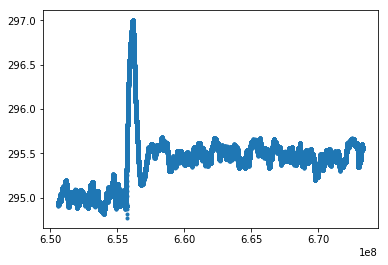

In [8]:
%matplotlib inline
import matplotlib.pyplot as plt
from Ska.Matplotlib import plot_cxctime
import math

size = 500
msid_value = '4OAVHRMT'
msid_set, pitch = data[msid_value], data['DP_PITCH']

#here we plot our graph and take out any obvious outliers 
fig, axs = plt.subplots(1, 1)
msid_set = pd.DataFrame({'times': msid_set.times, 'vals': msid_set.vals})
msid_set = msid_set[(msid_set['vals']<300)&(msid_set['vals']>290)]
axs.plot(msid_set.times, msid_set.vals, '.')

In [10]:
msid_df = pd.DataFrame({'times': msid_set.times, 'vals': msid_set.vals})
#msid = msid_df
msid = msid_df[(msid_df['vals']<300) & (msid_df['vals']>290)]
#ACTION ITEM: if this is the first time pulling data for a specific MSID 
#then uncomment the following line along with the "save" otherwise read_pickle
#combined_dict = get_all_data(msid, data, pitch)

import pickle
saved_msid_data = msid_value + 'msid_data.pkl'
#f = open(saved_msid_data, "wb")
#pickle.dump(combined_dict, f)
#f.close()
combined_dict = pd.read_pickle(saved_msid_data)

In [14]:
# DATA MANIPULATION AND TRANSFORMATION
# since the data sometimes bounces back and forth between values I think the best way to train
# is to take an aveage and let the "back and forth" be covered by the uncertainty of a value
# the spacing_int determines what gets averaged, would be better to create a concept of density 
spacing_int = 30
cols = ['msid_times', 'msid_vals', 'pitch', 'roll']
pos = ['pitch', 'roll']
n_features = 3
frames = 8
sig_figs = 6

################# FIRST TRANSFORM ALL DATA ######################
combined_obs_full = pd.DataFrame(combined_dict)

combined_obs_subset = combined_obs_full[cols]
#take out any null values
mask = [all(tup) for tup in zip(*[~np.isnan(combined_obs_subset['{}'.format(i)]) for i in pos])]
combined_obs_masked = combined_obs_subset[mask]

from sklearn.preprocessing import MinMaxScaler

#drop time - we have uneven time frames...
#not sure how this will affect the algorithm but when refining will take a look
msid_times_full = combined_obs_masked['msid_times']
raw = combined_obs_masked.drop('msid_times', axis = 1)
raw_msid_val = combined_obs_masked.drop(pos+['msid_times'], axis = 1)

#normalize data (to be between 0 and 1) and then reshape 
scaler_full = MinMaxScaler()
scaled = scaler_full.fit_transform(raw)
#creating a seperate scaling for msid_vals cause honestly it's ruining my life
scaler_msid = MinMaxScaler()
scaled_msid_val = scaler_msid.fit_transform(raw_msid_val)

scaled_df = pd.DataFrame(scaled, columns = raw.columns)

shaped_full, begin_int = shaping_data(scaled_df, pos, frames)

#####################AVERAGING############################

#need to pad the data so that averaging works
padding_int = spacing_int - (scaled_df['msid_vals'].shape[0]%spacing_int)
padding = np.empty(padding_int, dtype=np.float32)
padded_msid_vals = np.concatenate((scaled_df['msid_vals'], padding), axis=0)
padded_pitch_vals = np.concatenate((scaled_df['pitch'], padding), axis = 0)
padded_roll_vals = np.concatenate((scaled_df['roll'], padding), axis = 0)
#padded_yaw_vals = np.concatenate((combined_dict['yaw'], padding), axis = 0)

avg_msid_vals = np.mean(padded_msid_vals.reshape(-1,spacing_int), axis=1)[:-1]
avg_pitch_vals = np.mean(padded_pitch_vals.reshape(-1,spacing_int), axis=1)[:-1]
avg_roll_vals = np.mean(padded_roll_vals.reshape(-1,spacing_int), axis=1)[:-1]
#avg_yaw_vals = np.mean(padded_yaw_vals.reshape(-1,spacing_int), axis=1)[:-1]

# time isn't averaged which might make plotting weird but won't affect training so...
intrv_times = msid_times_full[::spacing_int][:-1]

#TODO: change shaping data to take in list of names to go in a dict, create df and shape it 
intervaled_dict = {'msid_vals': rounded(avg_msid_vals, sig_figs),
                   'pitch': rounded(avg_pitch_vals, sig_figs), 
                   'roll': rounded(avg_roll_vals, sig_figs)}

intervaled_obs = pd.DataFrame(intervaled_dict)
print(intervaled_obs[:5])
shaped_avg, begin_int_avg = shaping_data(intervaled_obs, pos, frames)
print (shaped_avg.shape)

   msid_vals     pitch   roll
0   0.071464  0.704059  0.675
1   0.071636  0.703976  0.675
2   0.072155  0.703933  0.675
3   0.071810  0.703860  0.675
4   0.071636  0.703807  0.675
(22632, 25)


(1, 22640)


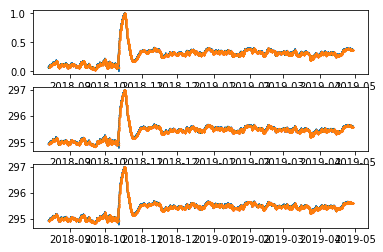

In [16]:
#test to quickly show that scaling is reversible and averages work
unscaled = scaler_full.inverse_transform(scaled_df)
unscaled_df = pd.DataFrame(unscaled, columns = raw.columns)

unscaled_msid_vals = scaler_msid.inverse_transform(np.atleast_2d(avg_msid_vals))
print (unscaled_msid_vals.shape)

#size = 500
#msid_value = '4OAVHRMT'
#msid_set, pitch = data[msid_value], data['DP_PITCH']
fig, axs = plt.subplots(3, 1)
axs[0].plot(msid_times_full, scaled_df.msid_vals, intrv_times, intervaled_obs.msid_vals, '.' , markersize = 1)
axs[1].plot(msid_times_full, unscaled_df.msid_vals, intrv_times, unscaled_msid_vals[0], '.' , markersize=1)
axs[2].plot(combined_obs_full.msid_times, combined_obs_full.msid_vals,intrv_times, unscaled_msid_vals[0], '.', markersize=1)


In [17]:
################ SPLITTING AND SHAPING DATA ###############

shaped = shaped_avg
unshaped_msid_v = intervaled_obs.msid_vals
offset = begin_int_avg

#split into train, validation and test sets
split_size = int(shaped.shape[0]/8.0)
first_split, last_split = 4, 6
train = shaped[:split_size*first_split, :]
#train_unshaped = unshaped_msid_v[offset : split_size*first_split+offset]
train_time = intrv_times[:split_size*first_split+offset]
print ("train shapes: ", train.shape, train_time.shape)

validate = shaped[split_size*first_split:split_size*last_split, :]
#val_unshaped = unshaped_msid_v[ offset + split_size*first_split : split_size*last_split+offset]
val_time = intrv_times[ offset + split_size*first_split : split_size*last_split + offset ]
print ("validate shapes: ", validate.shape, val_time.shape)

test = shaped[split_size*last_split: , :]
#test_unshaped = unshaped_msid_v[split_size*last_split + offset :]
test_time = intrv_times[split_size*last_split + offset: ]
print ("test shapes: ", test.shape, test_time.shape)

#split into inputs and outputs
train_X, train_y = train[:, :-1], train[:, -1]
test_X, test_y = test[:, :-1], test[:, -1]
validate_X, validate_y = validate[:, :-1], validate[:, -1]

# reshape input to be 3D tensor with shape (samples, timesteps, features]
print (train_X.shape, train_y.shape, test_X.shape, test_y.shape)
train_X = train_X.reshape((train_X.shape[0], frames, n_features))
test_X = test_X.reshape((test_X.shape[0], frames, n_features))
validate_X = validate_X.reshape((validate_X.shape[0], frames, n_features))
print (train_X.shape, train_y.shape, test_X.shape, test_y.shape)


#***********************************************************************#
# This is all for plotting purposes
# because we removed null columns we want to ignore first couple of rows,
# this is important when we are transforming back, not so much here

#dash_time = dash_times[-time_split:]
#***********************************************************************#
msid_val_full = raw_msid_val.msid_vals.values
split_size_full = int(msid_val_full.shape[0]/8.0)
print ("full shapes: " , msid_val_full.shape , msid_times_full.shape)
test_full = msid_val_full[ begin_int + split_size_full * last_split : ]
test_time_full = msid_times_full[ begin_int + split_size_full * last_split : ]
print ("test_time_full: ", test_time_full.shape)


val_full = msid_val_full[split_size_full*first_split:split_size_full*last_split]
val_time_full = msid_times_full[split_size_full*first_split:split_size_full*last_split]

train_full = msid_val_full[:split_size_full*first_split]
train_time_full = msid_times_full[:split_size_full*first_split]


############## FULL FOR ALGO  ###################
#split into inputs and outputs
print ("shaped_full: ", shaped_full.shape)
test_full_shaped = shaped_full[split_size_full*last_split: , :]
test_X_full, test_y_full = test_full_shaped[:, :-1], test_full_shaped[:, -1]
print ("full shape: ", test_X_full.shape , test_y_full.shape)
# reshape input to be 3D tensor with shape (samples, timesteps, features]
test_X_full = test_X_full.reshape((test_X_full.shape[0], frames, n_features))
time_split_full = test_X_full.shape[0]
time_test_full = msid_times_full[-time_split_full:]

validate_full_shaped = shaped_full[split_size_full*first_split : split_size_full*last_split, :]
validate_X_full, validate_y_full = validate_full_shaped[:, :-1], validate_full_shaped[:, -1]
validate_X_full = validate_X_full.reshape((validate_X_full.shape[0], frames, n_features))


train shapes:  (11316, 25) (11324,)
validate shapes:  (5658, 25) (5658,)
test shapes:  (5658, 25) (5658,)
(11316, 24) (11316,) (5658, 24) (5658,)
(11316, 8, 3) (11316,) (5658, 8, 3) (5658,)
full shapes:  (679229,) (679229,)
test_time_full:  (169803,)
shaped_full:  (679221, 25)
full shape:  (169803, 24) (169803,)


In [18]:
# taken from "A Theoretically Grounded Application of Dropout in Recurrent Neural Networks"
# by Yarin Gal and Zoubin Ghahramani and corresponding github code
from keras.callbacks import Callback
from keras import backend as K
from keras import models, callbacks


from keras.models import Sequential
from keras.layers.core import Dense, Dropout
from keras.layers.recurrent import LSTM
from keras.regularizers import l2
from keras.engine import training_arrays

class ModelTest(Callback):
    ''' Test model at the end of every X epochs.
    The model is tested using both MC dropout and the dropout
    approximation. Output metrics for various losses are supported.
    # Arguments
        Xt: model inputs to test.
        Yt: model outputs to get accuracy / error (ground truth).
        T: number of samples to use in MC dropout.
        test_every_X_epochs: test every test_every_X_epochs epochs.
        batch_size: number of data points to put in each batch
            (often larger than training batch size).
        verbose: verbosity mode, 0 or 1.
        loss: a string from ['binary', 'categorical', 'euclidean']
            used to calculate the testing metric.
        mean_y_train: mean of outputs in regression cases to add back
            to model output ('euclidean' loss).
        std_y_train: std of outputs in regression cases to add back
            to model output ('euclidean' loss).
    # References
        - [Dropout: A simple way to prevent neural networks from overfitting](http://jmlr.org/papers/v15/srivastava14a.html)
        - [Dropout as a Bayesian Approximation: Representing Model Uncertainty in Deep Learning](http://arxiv.org/abs/1506.02142)
    '''
    def __init__(self, Xt, Yt, T=10, test_every_X_epochs=1, batch_size=500, verbose=1,
                 loss=None, mean_y_train=None, std_y_train=None):
        super(ModelTest, self).__init__()
        self.Xt = Xt
        self.Yt = np.array(Yt)
        self.T = T
        self.test_every_X_epochs = test_every_X_epochs
        self.batch_size = batch_size
        self.verbose = verbose
        self.loss = loss
        self.mean_y_train = mean_y_train
        self.std_y_train = std_y_train
        self._predict_stochastic = None
        
    def predict_stochastic(self, X, batch_size=128, verbose=0):
        '''Generate output predictions for the input samples
        batch by batch, using stochastic forward passes. If
        dropout is used at training, during prediction network
        units will be dropped at random as well. This procedure
        can be used for MC dropout (see [ModelTest callbacks](callbacks.md)).
        # Arguments
            X: the input data, as a numpy array.
            batch_size: integer.
            verbose: verbosity mode, 0 or 1.
        # Returns
            A numpy array of predictions.
        # References
            - [Dropout: A simple way to prevent neural networks from overfitting](http://jmlr.org/papers/v15/srivastava14a.html)
            - [Dropout as a Bayesian Approximation: Representing Model Uncertainty in Deep Learning](http://arxiv.org/abs/1506.02142)
        '''
        #X = models.standardize_X(X)
        #[model.layers[0].input, K.learning_phase()],
        #       [model.layers[-1].output]
        if self._predict_stochastic is None: # we only get self.model after init
            print (self.model.predict_function)
            self._predict_stochastic = K.function([self.model.inputs[0], K.learning_phase()], [self.model.outputs[0]])
        self.model.predict_function = self._predict_stochastic
        predictions = self.model.predict(X, batch_size, verbose)
        return predictions


Using TensorFlow backend.


In [28]:
###### np.random.seed(0)
timesteps, data_dim = train_X.shape[1], train_X.shape[2]


mean_y_train, std_y_train = np.mean(train_y) , np.std(train_y)
p_W, p_U, p_dense, weight_decay, batch_size, n_neurons = 0.05, 0.05, 0.05, 1e-6, 512, 8

################## Neural Network ###################
# here we have a one layer LSTM neural network
model=Sequential()
model.add(LSTM(n_neurons, input_shape = (timesteps, data_dim), kernel_regularizer=l2(weight_decay), U_regularizer=l2(weight_decay),
               bias_regularizer=l2(weight_decay), dropout=p_W, recurrent_dropout=p_U))
#model.add(LSTM(n_neurons, dropout_W=p_W, dropout_U=p_U))
model.add(Dropout(p_dense))
model.add(Dense(1,  kernel_regularizer=l2(weight_decay), bias_regularizer=l2(weight_decay)))

#optimiser = SGD(lr=0.1, decay=1e-6, momentum=0.9, nesterov=False)
optimiser = 'adam'
model.compile(loss='mean_squared_error', optimizer=optimiser, metrics = ['accuracy'])

###### Taken from Yarin Gal and used as callbacks ######
modeltest_1 = ModelTest(train_X[:batch_size],
                        mean_y_train + std_y_train * np.atleast_2d(train_y[:batch_size]).T, 
                        test_every_X_epochs=1, verbose=0, loss='euclidean', 
                        mean_y_train=mean_y_train, std_y_train=std_y_train, batch_size=batch_size)

tensorflow_test_size = int(batch_size * (len(test_X) / batch_size))

modeltest_2 = ModelTest(test_X[:tensorflow_test_size], np.atleast_2d(test_y[:tensorflow_test_size]).T, 
                        test_every_X_epochs=1, verbose=0, loss='euclidean', 
                        mean_y_train=mean_y_train, std_y_train=std_y_train, batch_size=batch_size)

### checkpoint saves the model with the best val_loss
checkpoint_path = 'weights_best_{}_pW_{}_pU_{}_pdense{}'.format(msid_value, p_W, p_U, p_dense)
checkpointer = callbacks.ModelCheckpoint(filepath= checkpoint_path,
                                         verbose = 0, save_best_only = True,
                                         save_weights_only = True, mode = 'min')


tensorflow_train_size = int(batch_size * (len(train_X) / batch_size))
history = model.fit(train_X, train_y,validation_data=(validate_X_full, validate_y_full),
          batch_size=batch_size, epochs=260, callbacks=[ checkpointer, modeltest_1, modeltest_2], shuffle = False , verbose = 0)


'''
modeltest_1 = ModelTest(train_X[:100],
                        mean_y_train + std_y_train * np.atleast_2d(train_y[:100]).T, 
                        test_every_X_epochs=1, verbose=0, loss='euclidean', 
                        mean_y_train=mean_y_train, std_y_train=std_y_train)
modeltest_2 = ModelTest(test_X, np.atleast_2d(test_y).T, test_every_X_epochs=1,
                        verbose=0, loss='euclidean', 
                        mean_y_train=mean_y_train, std_y_train=std_y_train)

model.fit(train_X , train_y, batch_size=512, nb_epoch = 5, 
         callbacks=[modeltest_1, modeltest_2])
         '''
print(model.summary())

/home/lduque/miniconda3/envs/ska3/lib/python3.6/site-packages/ipykernel/__main__.py:12: UserWarning: Update your `LSTM` call to the Keras 2 API: `LSTM(8, input_shape=(8, 3), kernel_regularizer=<keras.reg..., bias_regularizer=<keras.reg..., dropout=0.05, recurrent_dropout=0.05, recurrent_regularizer=<keras.reg...)`


Model: "sequential_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_3 (LSTM)                (None, 8)                 384       
_________________________________________________________________
dropout_3 (Dropout)          (None, 8)                 0         
_________________________________________________________________
dense_3 (Dense)              (None, 1)                 9         
Total params: 393
Trainable params: 393
Non-trainable params: 0
_________________________________________________________________
None


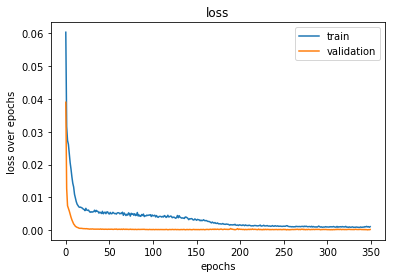

In [21]:
# this plot gives us info on how our model is doing and whether it's being under/over fit
plt.plot(history.history['loss'], label = 'train')
plt.plot(history.history['val_loss'], label = 'validation')
plt.title('loss')
plt.xlabel('epochs')
plt.ylabel('loss over epochs')
plt.legend()
plt.show()

In [22]:
# (Averaged model)
#### testing uncertainty algorithm structure from Lingxue Zhu 2017
######### STEP ONE IS MCdropout ###########
# inputs: data x* , encoder g(), prediction network h(), dropout probability p, number of iterations B
# outputs: prediction y-hat(mc), uncertainty nu_1
model.load_weights(checkpoint_path)

B = 200
predictions = np.array([modeltest_2.predict_stochastic(test_X, batch_size=batch_size, verbose=0)
                 for _ in range(B)])

############### FIRST SCALE ###########
scaled_predictions = []
min_ , scale_ = scaler_msid.min_[0] , scaler_msid.scale_[0]
for x in predictions:
    scl = scaler_msid.inverse_transform(x)
    scaled_predictions += [scl]

scaled_predictions = np.array(scaled_predictions)
############## PREDICTION IS MEAN OF B TIMES ############33
scaled_y_hat = np.mean(scaled_predictions, 0)
# MODEL UNCERTAINTY AND MISSPECIFICATION
nu_1_squared_scaled = np.var(scaled_predictions, 0)
print (np.mean(nu_1_squared_scaled), np.max(nu_1_squared_scaled), np.min(nu_1_squared_scaled))

############ STEP 2: INFERENCE ###########
# inputs: data x* , encoder g(), prediction network h(), dropout probability p, number of iterations B
pred_v = model.predict(validate_X, batch_size=batch_size, verbose=1)
pred_v_scaled = scaler_msid.inverse_transform(pred_v)
val_scaled = scaler_msid.inverse_transform([validate_y])
# inherent noise
nu_2_squared_scaled = np.mean((pred_v_scaled - np.atleast_2d(val_scaled).T)**2)
print(nu_2_squared_scaled)

# total prediction uncertainty 
nu_scaled = np.squeeze(np.sqrt(nu_1_squared_scaled + nu_2_squared_scaled))

print(np.min(nu_scaled), np.max(nu_scaled))
print(nu_scaled[:5])

#nu = np.sqrt(nu_1_squared + nu_2_squared)

None
2.3793547e-07 7.301569e-07 0.0
5658/5658 [==============================] - 0s 3us/step
0.00023937992193855074
0.015471907 0.015495486
[0.01547239 0.01547961 0.01548277 0.01547624 0.01547868]


In [23]:
# full model
#testing uncertainty algorithm structure from Lingxue Zhu 2017
######### STEP ONE IS MCdropout ###########
# inputs: data x* , encoder g(), prediction network h(), dropout probability p, number of iterations B
# outputs: prediction y-hat(mc), uncertainty nu_1
model.load_weights(checkpoint_path)

B = 200
predictions = np.array([modeltest_2.predict_stochastic(test_X_full, batch_size=batch_size, verbose=0)
                 for _ in range(B)])

############### FIRST SCALE ###########
scaled_predictions = []
min_ , scale_ = scaler_msid.min_[0] , scaler_msid.scale_[0]
for x in predictions:
    scl = scaler_msid.inverse_transform(x)
    scaled_predictions += [scl]

scaled_predictions = np.array(scaled_predictions)
############## PREDICTION IS MEAN OF B TIMES ############33
scaled_y_hat = np.mean(scaled_predictions, 0)
# MODEL UNCERTAINTY AND MISSPECIFICATION
nu_1_squared_scaled = np.var(scaled_predictions, 0)
print (np.mean(nu_1_squared_scaled), np.max(nu_1_squared_scaled), np.min(nu_1_squared_scaled))

############ STEP 2: INFERENCE ###########
# inputs: data x* , encoder g(), prediction network h(), dropout probability p, number of iterations B
pred_v = model.predict(validate_X_full, batch_size=batch_size, verbose=1)
pred_v_scaled = scaler_msid.inverse_transform(pred_v)
val_scaled = scaler_msid.inverse_transform([validate_y_full])
# inherent noise
nu_2_squared_scaled = np.mean((pred_v_scaled - np.atleast_2d(val_scaled).T)**2)
print(nu_2_squared_scaled)

# total prediction uncertainty 
nu_scaled = np.squeeze(np.sqrt(nu_1_squared_scaled + nu_2_squared_scaled))

print(np.min(nu_scaled), np.max(nu_scaled))
print(nu_scaled[:5])

#nu = np.sqrt(nu_1_squared + nu_2_squared)

2.3372849e-07 7.301569e-07 0.0
169806/169806 [==============================] - 1s 3us/step
0.00029743914546682623
0.017246423 0.01726758
[0.01725099 0.01724815 0.01724969 0.01726329 0.01725617]


In [24]:
## here we are transforming the scaling 
from sklearn.metrics import mean_squared_error

yhat = scaled_y_hat
timesteps, data_dim = test_X_full.shape[1] , test_X_full.shape[2]
test_X1 = test_X_full.reshape((test_X_full.shape[0], timesteps*data_dim))
print("Test X1 shape:", test_X1.shape)
print("yhat shape:", yhat.shape)

#number of predictive variables
p_var = n_features -1
#invert scaling from 0 to 1 for forecast
#here we need to return to our original form of hrma_temp(predicted) and pitch(actual)
inv_yhat = np.concatenate((yhat, test_X1[:,-p_var:]), axis = 1)
inv_yhat1 = scaler_full.inverse_transform(inv_yhat)
inv_ypred = inv_yhat1[:,0]

#invert scaling from 0 to 1 for 
test_y1 = test_y_full.reshape((len(test_y_full), 1))
#here we return to our original form of hrma_temp(actual) and pitch(actual)
inv_y = np.concatenate((test_y1, test_X1[:,-p_var:]), axis = 1)
inv_y1 = scaler_full.inverse_transform(inv_y)
inv_yactual= inv_y1[:,0]

############### IMPORTANT#############
inv_ypred= np.squeeze(scaled_y_hat)
######################################

rmse = np.sqrt(mean_squared_error(inv_yactual, inv_ypred))
#here I'm using Mean Squared Error but obvi we can change this
print('Test RMSE: %.4f' % rmse)

print (inv_ypred.shape)

Test X1 shape: (169803, 24)
yhat shape: (169803, 1)
Test RMSE: 0.0145
(169803,)


In [25]:

#p = figure(title = ('Predicted vs Actual {}'.format(msid_value)), x_axis_label = 'time', 
#           y_axis_label = 'temp', x_axis_type = "datetime")
#plot actual and predicted temperature vs. time
#p.circle(time_test, inv_yactual, legend="actual")
#print (len(time_test))

### errror for plotting ###
test_time = test_time_full
z_alpha_half = 2.576

err_xs = []
err_ys = []
print (test_time.shape)
for x, y, yerr in zip(test_time, inv_ypred, nu_scaled):
    err_xs.append((x, x))
    err_ys.append((y-(z_alpha_half*yerr), y+ (z_alpha_half*yerr)))
#p.multi_line(err_xs,err_ys, color='grey')

'''
#p.circle(time_test, inv_ypred, legend="predicted", color = 'red', fill_alpha = 0.5, line_width = 0.01)
p.circle(test_time, inv_ypred, legend="pred. w/ uncertainty", color = 'pink', fill_alpha = 0.5, line_width = 0.01)
p.circle(train_time_full, train_full, legend = 'training', color = 'green', fill_alpha = 0.5, line_width = 0.01)
p.circle(val_time_full, val_full, legend = 'validation', color = 'blue', fill_alpha = 0.5, line_width = 0.01)





p.xaxis.formatter = DatetimeTickFormatter(
                                minutes = ["%Y:%j:%H:%M"],
                                hours = ["%Y:%j:%H"],
                                hourmin = ["%Y:%j:%H:%M"],
                                days = ["%Y:%j"]
                        )
show(p)
#export_png(p, '{}_breakdown_plot.png'.format(msid_value))'''
print (len(err_xs), len(err_ys), test_time.shape, inv_yactual.shape, inv_ypred.shape)

(169803,)
169803 169803 (169803,) (169803,) (169803,)


In [27]:
import math 
size = 600
height = 400
test_time = test_time_full

##########################
# Plotting Predicted vs Actual
#x axis is time, y axis is temperatures
##########################
p = figure(title = ('Predicted vs Actual {}'.format(msid_value)), x_axis_label = 'time', 
           y_axis_label = 'temp', x_axis_type = "datetime", plot_height = height, plot_width = size)
#plot actual and predicted temperature vs. time
#p.circle(time_test, inv_yactual, legend="actual")
#p.circle(time_test, inv_ypred, legend="predicted", color = 'red')
p.multi_line(err_xs,err_ys, color='grey', legend = 'uncertainty')
p.circle(test_time, inv_ypred, legend = 'predicted', color = 'red',  fill_alpha = 0.2, line_width = 0.01)
p.circle(test_time, inv_yactual, legend = 'original', color = 'green', fill_alpha = 0.2, line_width = 0.01)
p.xaxis.formatter = DatetimeTickFormatter(
                                minutes = ["%Y:%j:%H:%M"],
                                hours = ["%Y:%j:%H"],
                                hourmin = ["%Y:%j:%H:%M"],
                                days = ["%Y:%j"]
                        )
p.xaxis.major_label_orientation = math.pi/4

p.legend.location = "bottom_left"

#########################
# Plotting Model Error which is just actual y value minus test y value
# x axis is time, y axis is error 
#########################
errors =  inv_yactual - inv_ypred
one_perc = np.quantile(errors, 0.01)
nn_perc = np.quantile(errors, .99)
scale = np.ptp(inv_yactual)/2.0
e = figure(title = ('Model Error (Actual - Test) {}'.format(msid_value)), x_axis_label = 'time', 
           y_axis_label = 'error (deg)', x_axis_type = "datetime", plot_height = 200, plot_width = size,
           y_range = (-scale, scale), x_range = p.x_range)
#plot actual and predicted temperature vs. time
#p.circle(time_test, inv_yactual, legend="actual")
e.circle(test_time, errors, color = 'green', line_width = 0.05)
#print(time_test.shape, errors.shape)
e.xaxis.formatter = DatetimeTickFormatter(
                                minutes = ["%Y:%j:%H:%M"],
                                hours = ["%Y:%j:%H"],
                                hourmin = ["%Y:%j:%H:%M"],
                                days = ["%Y:%j"]
                        )
e.xaxis.major_label_orientation = math.pi/4

#########################
# Plotting Error by Temperature
# 
#########################
m = figure(title = 'Actual vs. Model Error {}'.format(msid_value), x_axis_label = 'error (deg)', 
           y_axis_label = 'temp',  x_range = (-scale, scale), y_range = p.y_range,
          plot_height = height, plot_width = height)
#plot actual and predicted temperature vs. time
#p.circle(time_test, inv_yactual, legend="actual")
m.circle(errors, inv_yactual, color = 'green', line_width = 0.01)


def make_histogram(title, hist, edges, x):
    h = figure(title = title, tools = ' ',  x_range = m.x_range, plot_height = 200, plot_width = height)
    h.quad(top = hist, bottom = 0, left = edges[:-1], right = edges[1:],
          line_color = "white", fill_color = "green")
    h.y_range.start = 0
    return h

hist, edges = np.histogram(errors, density = True, bins = 25)
#print(hist, edges)
hist = hist*1.0/sum(hist)
histogram = make_histogram("Error Distribution {}".format(msid_value), hist, edges, errors)

show(gridplot([[p,m],[e, histogram]]))